# EXPLORATORY DATA ANALYSIS

The goal of our analysis is to understand how the wind speed behaves over time, and propose the most adaqueate way of forecasting its _day ahead_.

Before advancing into forecasting, it is very important to be aware of the statistical behavior of the time series. In order to do that, the present Notebook focuses on the visual analysis as well as an exploration of possible Python packages that could come in hand when decomposing the time series and improving the understand of how the wind speed behaves over time.

One, relatively new Python package is called [`statsmodels`](https://www.statsmodels.org/stable/index.html), it came from the SciPy `scipy.stats` module, and is currently supported as a standalode package,



In [ ]:
import pandas as pd
import plotly.express as px
import plotly.graph_objs as go

from plotly.subplots import make_subplots

viridis_scale = px.colors.sequential.Viridis

## Loading the Dataset

In [2]:
df = pd.read_csv('datasets/wind.csv', usecols = ['TIME','WIND_SPD_TOP'], index_col=['TIME'], parse_dates=['TIME'])
df.rename(columns = {'WIND_SPD_TOP':'speed'}, inplace = True)
df.index.rename('time', inplace=True)
df.head()

,speed
time,
2015-01-01 00:00:00,12.69
2015-01-01 00:10:00,11.92
2015-01-01 00:20:00,12.90
2015-01-01 00:30:00,12.21
2015-01-01 00:40:00,11.98


## Visualizing

The following cell shows the _10min average_ wind speed. Eventhough it would be interesting to work on this level of granularity, the average over longer periods of time might show aditional statiscal behaviours.

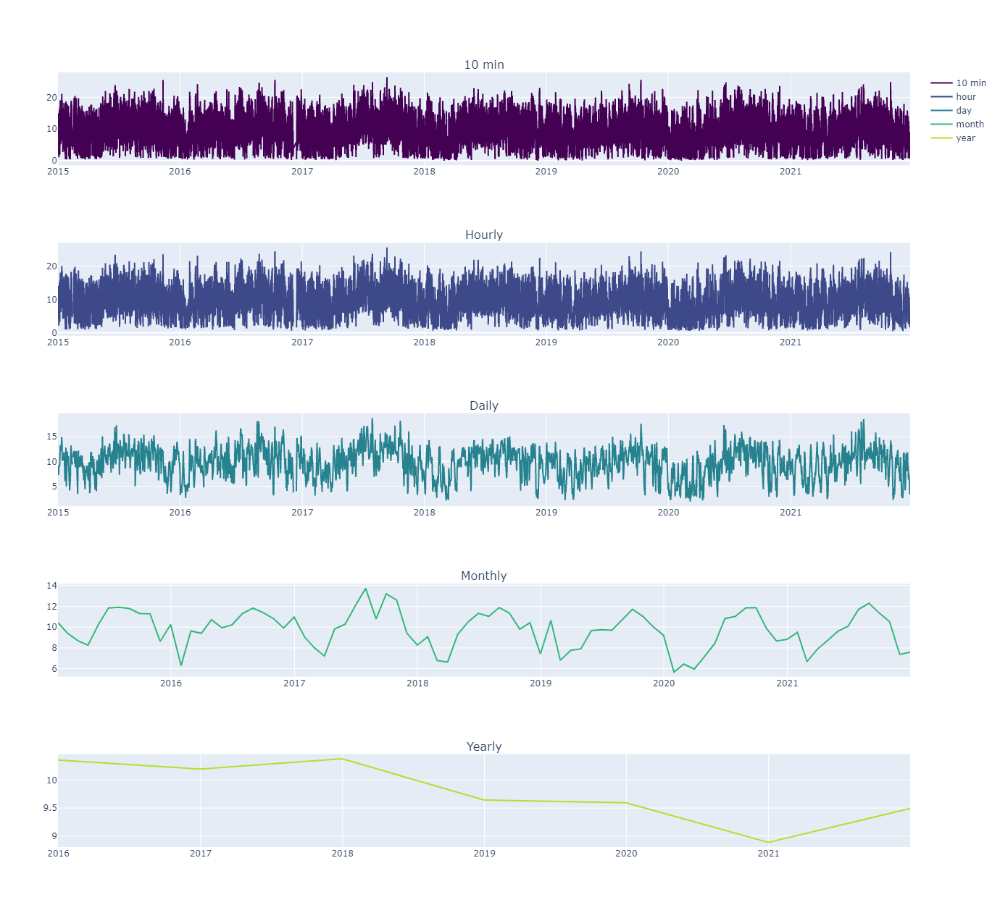

In [24]:
min10 = go.Scatter(
            name='10 min',
            x=df.index,
            y=df.speed,
            mode='lines',
            line=dict(color=viridis_scale[0]))
hourly = go.Scatter(
            name='hour',
            x=df.resample('h').mean().index,
            y=df.resample('h').mean().speed,
            mode='lines',
            line=dict(color=viridis_scale[2]))
day = go.Scatter(
            name='day',
            x=df.resample('d').mean().index,
            y=df.resample('d').mean().speed,
            mode='lines',
            line=dict(color=viridis_scale[4]))
month = go.Scatter(
            name='month',
            x=df.resample('m').mean().index,
            y=df.resample('m').mean().speed,
            mode='lines',
            line=dict(color=viridis_scale[6]))
year = go.Scatter(
            name='year',
            x=df.resample('y').mean().index,
            y=df.resample('y').mean().speed,
            mode='lines',
            line=dict(color=viridis_scale[8]))
box_fig = px.box(df,labels={"value": "Wind Speed (m/s)","time": "Time"})
box = box_fig['data'][0]


fig = make_subplots(rows=5, cols=1, subplot_titles=("10 min", "Hourly", "Daily", "Monthly", "Yearly"), shared_yaxes=True)
#fig = go.Figure()
fig.update_layout(height=1250)
fig.add_trace(min10, row=1, col=1)
fig.add_trace(hourly, row=2, col=1)
fig.add_trace(day, row=3, col=1)
fig.add_trace(month, row=4, col=1)
fig.add_trace(year, row=5, col=1)